In [1]:
import os
import random
import numpy as np
from tqdm import tqdm
import shutil
from IPython.display import HTML

import matplotlib
import matplotlib.pyplot as plt
import matplotlib.animation as animation
matplotlib.rcParams['figure.figsize'] = [5, 5]
matplotlib.rcParams['figure.dpi'] = 200

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.nn import init

import torchvision
import torchvision.transforms as transforms
import torchvision.utils as vutils

from data_helper import UnlabeledDataset, LabeledDataset
from helper import collate_fn, draw_box

In [2]:
random.seed(0)
np.random.seed(0)
torch.manual_seed(0);

device = ("cuda:0" if torch.cuda.is_available() else "cpu")

In [3]:
data_dir = '/home/alexander/data'
annotation_csv = '/home/alexander/data/annotation.csv'

resume_training_from_checkpoint = True
load_checkpoint_path = 'training_checkpoints/GANLossBCE_L1Loss_epoch_100to200_checkpoint.pth.tar'
save_checkpoint_path = 'training_checkpoints/GANLossBCE_L1Loss_epoch_100to200_checkpoint.pth.tar'

In [4]:
def save_checkpoint(fpath, state):
    torch.save(state, fpath)
    
def print_sys_mem_usage():
    print("Memory usage (RAM):\n")
    !free -h
    print("\nGPU Memory Usage:\n")
    !nvidia-smi --query-gpu=memory.used --format=csv
    !nvidia-smi --query-gpu=memory.total --format=csv
    print("\n")
    
def print_train_stats(epoch, n_epochs, i, n_batches, loss_d_total, loss_g_total, d_real_mean, d_gen_mean_pre, d_gen_mean_post):
    print('Epoch: [%d/%d]\tBatch: [%d/%d]\n' % (epoch + 1, n_epochs, i, n_batches),
          'Loss_D: %.4f\tLoss_G: %.4f\n' % (loss_d_total.item(), loss_g_total.item()),
          'D(real): %.4f  ||  D(gen) Pre-step: %.4f  ||  D(gen) Post-step: %.4f\n' %
          (d_real_mean, d_gen_mean_pre, d_gen_mean_post))

### Set Initial Parameters

In [5]:
batch_size = 32

### Create Dataset and Dataloader

In [6]:
unlabeled_scene_index = np.arange(106)
labeled_scene_index_train = np.arange(106, 130)
labeled_scene_index_test = np.arange(130, 134)

In [7]:
labeled_trainset = LabeledDataset(image_folder=data_dir,
                                  annotation_file=annotation_csv,
                                  scene_index=labeled_scene_index_train,
                                  img_transform=transforms.Compose([transforms.CenterCrop(256),
                                                                    transforms.ToTensor(),
                                                                    transforms.Normalize(mean=(0.5,), std=(0.5,))
                                                                   ]),
                                  map_transform=transforms.Compose([transforms.ToPILImage(),
                                                                    transforms.Resize(256),
                                                                    transforms.ToTensor()
                                                                   ]),
                                  extra_info=True
                                 )

trainloader = torch.utils.data.DataLoader(labeled_trainset,
                                          batch_size=batch_size,
                                          shuffle=True,
                                          num_workers=2,
                                          collate_fn=collate_fn,
                                          pin_memory=True)

In [8]:
labeled_trainset[1][0].size()

torch.Size([18, 256, 256])

In [9]:
for images, road_maps in trainloader:
    print(images.size())
    break

torch.Size([32, 18, 256, 256])


### Define models

In [10]:
class ResnetBlock(nn.Module):
    """
    Define a Resnet block
    A resnet block is a conv block with skip connections
    Original Resnet paper: https://arxiv.org/pdf/1512.03385.pdf
    """
    def __init__(self, dim):
        """
        Parameters:
            dim (int)           -- the number of channels in the conv layer.
            padding_type (str)  -- the name of padding layer: reflect | replicate | zero
            use_dropout (bool)  -- if use dropout layers.
            use_bias (bool)     -- if the conv layer uses bias or not
        """
        super(ResnetBlock, self).__init__()
        self.resnet_block = nn.Sequential(nn.Conv2d(dim, dim, kernel_size=3, padding=1),
                                          nn.BatchNorm2d(dim),
                                          nn.ReLU(True),
                                          nn.Dropout(0.5),
                                          nn.Conv2d(dim, dim, kernel_size=3, padding=1),
                                          nn.BatchNorm2d(dim)
                                         )
        
    def forward(self, x):
        return x + self.resnet_block(x)  # add skip connections

In [11]:
class Generator(nn.Module):
    """
    RESNET-based generator that consists of Resnet blocks + downsampling/upsampling operations.
    """
    def __init__(self, in_ch, out_ch, ngf, n_blocks=6, init_gain=0.02):
        """
        Parameters:
            in_ch (int)         -- the number of channels in input images
            out_ch (int)        -- the number of channels in output images
            ngf (int)           -- the number of filters in the last conv layer
            n_blocks (int)      -- the number of ResNet blocks
            padding_type (str)  -- the name of padding layer in conv layers: reflect | replicate | zero
        """        
        assert(n_blocks >= 0)
        super(Generator, self).__init__()
        
        self.model = nn.Sequential(
            nn.ReflectionPad2d(3),
            
            nn.Conv2d(in_ch, ngf, kernel_size=7, padding=0),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            
            nn.Conv2d(ngf, ngf * 2, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            
            nn.Conv2d(ngf * 2, ngf * 4, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            
            ResnetBlock(ngf * 4),  #1
            ResnetBlock(ngf * 4),  #2
            ResnetBlock(ngf * 4),  #3
            ResnetBlock(ngf * 4),  #4
            ResnetBlock(ngf * 4),  #5
            ResnetBlock(ngf * 4),  #6
            ResnetBlock(ngf * 4),  #7
            ResnetBlock(ngf * 4),  #8
            ResnetBlock(ngf * 4),  #9

            nn.ConvTranspose2d(ngf * 4, int(ngf * 2), kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(int(ngf * 2)),
            nn.ReLU(True),
            
            nn.ConvTranspose2d(ngf * 2, int(ngf), kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(int(ngf)),
            nn.ReLU(True),

            nn.ReflectionPad2d(3),
            nn.Conv2d(ngf, out_ch, kernel_size=7, padding=0),
            nn.Tanh()
        )
        
    def forward(self, x):
        return self.model(x)

In [12]:
class Discriminator(nn.Module):
    def __init__(self, in_ch, ndf=64, n_layers=3):  
        super(Discriminator, self).__init__()
        
        self.block1 = nn.Sequential(nn.Conv2d(in_ch, ndf, kernel_size=4, stride=2, padding=1),
                                    nn.LeakyReLU(0.2, True)
                                   )
        
        nf_mult = 1
        nf_mult_prev = 1
        sequence2 = []        
        for n in range(1, n_layers):  # gradually increase the number of filters
            nf_mult_prev = nf_mult
            nf_mult = min(2 ** n, 8)
            sequence2 += [nn.Conv2d(ndf * nf_mult_prev, ndf * nf_mult, kernel_size=4, stride=2, padding=1),
                         nn.BatchNorm2d(ndf * nf_mult),
                         nn.LeakyReLU(0.2, True)
                         ]
        self.block2 = nn.Sequential(*sequence2)
        
        sequence3 = []
        nf_mult_prev = nf_mult
        nf_mult = min(2 ** n_layers, 8)
        sequence3 += [nn.Conv2d(ndf * nf_mult_prev, ndf * nf_mult, kernel_size=4, stride=1, padding=1),
                     nn.BatchNorm2d(ndf * nf_mult),
                     nn.LeakyReLU(0.2, True)
                     ]
        self.block3 = nn.Sequential(*sequence3)
        
        self.model = nn.Sequential(self.block1,
                                   self.block2,
                                   self.block3,
                                   nn.Conv2d(ndf * nf_mult, 1, kernel_size=4, stride=1, padding=1)
                                  )
        
    def forward(self, x):
        return self.model(x)

In [13]:
# # Sanity check - dimensions of inputs and outputs to both networks.

# test = torch.zeros([batch_size, 18, 256, 256])
# print("Input to generator:\t", test.size())

# test_generator = Generator(in_ch, out_ch, ngf, n_blocks=n_blocks_g, init_gain=0.02)
# test_result_g = test_generator(test)
# print("\nOutput of generator:\t", test_result_g.size())

# test_d_input = torch.cat((test_result_g, test), 1)
# print("\nInput to discriminator:\t", test_d_input.size())

# test_discriminator = Discriminator(in_ch + out_ch, ndf=ndf, n_layers=n_layers_d)
# test_result_d = test_discriminator(test_d_input)
# print("\nOutput of discriminator:", test_result_d.size())

In [14]:
class GANLoss(nn.Module):
    """
    The GANLoss class abstracts away the need to create the target label tensor
    that has the same size as the input.
    """
    def __init__(self, gan_mode, real_label=1.0, gen_label=0.0):
        """
        Parameters:
            gan_mode (str) - - the type of GAN objective. It currently supports vanilla, lsgan, and wgangp.
            target_real_label (bool) - - label for a real image
            target_gen_label (bool) - - label of a generated image
        Note: Do not use sigmoid as the last layer of Discriminator.
        LSGAN needs no sigmoid. vanilla GANs will handle it with BCEWithLogitsLoss.
        """
        super(GANLoss, self).__init__()
        
        self.gan_mode = gan_mode
        self.real_label = real_label
        self.gen_label = gen_label
        
        if gan_mode == 'LS':
            self.loss = nn.MSELoss().to(device)
        elif gan_mode == 'BCE':
            self.loss = nn.BCEWithLogitsLoss().to(device)

    def get_target_tensor(self, output, target_is_real):
        # Create label tensors with same size as the discriminator output.
        if target_is_real:
            if "cuda" in device:
                target_tensor = torch.cuda.FloatTensor([self.real_label])
            else:
                target_tensor = torch.Tensor([self.real_label])
        else:
            if "cuda" in device:
                target_tensor = torch.cuda.FloatTensor([self.gen_label])
            else:
                target_tensor = torch.Tensor([self.gen_label])
                
        return target_tensor.expand_as(output)

    def __call__(self, output, target_is_real):
        target_tensor = self.get_target_tensor(output, target_is_real)
        loss = self.loss(output, target_tensor)
        return loss

In [15]:
def init_weights(m):  # define the initialization function
    classname = m.__class__.__name__
    if hasattr(m, 'weight') and (classname.find('Conv') != -1 or classname.find('Linear') != -1):
        init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm2d') != -1:  # BatchNorm Layer's weight is not a matrix; only normal distribution applies.
        init.normal_(m.weight.data, 1.0, 0.02)
        init.constant_(m.bias.data, 0.0)

### Train

In [16]:
update_stats_rate = 25
debug_mem_usage = False
losses_g = []
losses_d = []
intermediate_images = []

In [17]:
in_ch = 18
out_ch = 1
ngf = 64
ndf = 64
n_blocks_g = 9
n_layers_d = 3

start_epoch = 0
n_epochs = 200
lr_g = 0.0001
lr_d = 0.0004
beta1 = 0.5
beta2 = 0.999
L1_lambda = 1

real_label = 0.95
gen_label = 0.0

In [18]:
generator = Generator(in_ch, out_ch, ngf, n_blocks=n_blocks_g, init_gain=0.02).to(device)
discriminator = Discriminator(in_ch + out_ch, ndf=ndf, n_layers=n_layers_d).to(device)

generator.apply(init_weights)
discriminator.apply(init_weights)

generator.train()
discriminator.train()


# We combine GAN Loss and L1 Loss to attain Total Loss
criterion_gan = GANLoss('BCE', real_label=real_label, gen_label=gen_label).to(device)
criterion_L1 = nn.L1Loss().to(device)

optim_G = torch.optim.Adam(generator.parameters(), lr=lr_g, betas=(beta1, beta2))
optim_D = torch.optim.Adam(discriminator.parameters(), lr=lr_d, betas=(beta1, beta2))

In [19]:
"""
Optional: Load checkpoint from most recent training run if resuming from previous trial.
"""
if resume_training_from_checkpoint:
    if os.path.isfile(load_checkpoint_path):
        print("=> loading checkpoint '{}'".format(load_checkpoint_path))
        
        checkpoint = torch.load(load_checkpoint_path)
        start_epoch = checkpoint['epoch']
        losses_g = checkpoint['losses_g']
        losses_d = checkpoint['losses_d']
        intermediate_images = checkpoint['intermediate_images']
        
        generator.load_state_dict(checkpoint['g_state_dict'])
        discriminator.load_state_dict(checkpoint['d_state_dict'])
        optim_G.load_state_dict(checkpoint['optim_g'])
        optim_D.load_state_dict(checkpoint['optim_d'])
        
        print("=> loaded checkpoint '{}' (epoch {})".format(load_checkpoint_path, checkpoint['epoch']))
    else:
        print("=> no checkpoint found at '{}'".format(load_checkpoint_path))

=> loading checkpoint 'training_checkpoints/GANLossBCE_L1Loss_epoch_100to200_checkpoint.pth.tar'
=> loaded checkpoint 'training_checkpoints/GANLossBCE_L1Loss_epoch_100to200_checkpoint.pth.tar' (epoch 151)


In [20]:
####################################
########## TRAINING LOOP ###########
####################################

n_batches = len(trainloader)
for epoch in range(start_epoch, n_epochs):
    iters = 1
    for real_18ch, real_map in tqdm(trainloader):
        """
        TRAIN DISCRIMINATOR ON BOTH REAL + GENERATED SAMPLES
        """
        real_18ch = real_18ch.to(device)
        real_map = real_map.to(device)
        
        gen_map = generator(real_18ch)
        
        real_19ch = torch.cat((real_18ch, real_map), 1).to(device)
        gen_19ch = torch.cat((real_18ch, gen_map), 1).to(device)

        output_real = discriminator(real_19ch)
        output_gen = discriminator(gen_19ch.detach())
        
        d_real_mean = output_real.mean().item()
        d_gen_mean_pre = output_gen.mean().item()

        # Make label tensors.
        target_real = torch.Tensor([real_label]).expand_as(output_real).to(device)
        target_gen = torch.Tensor([gen_label]).expand_as(output_gen).to(device)

        # Compute loss.
        loss_d_real = criterion_gan(output_real, target_is_real=True)
        loss_d_gen = criterion_gan(output_gen, target_is_real=False)
        loss_d_total = (loss_d_real + loss_d_gen)

        discriminator.zero_grad()
        loss_d_total.backward()
        optim_D.step()
        
        """
        TRAIN GENERATOR
        """
        output_gen = discriminator(gen_19ch)
        loss_g_gan = criterion_gan(output_gen, target_is_real=True)
        loss_g_L1 = L1_lambda * criterion_L1(gen_map, real_map)
        loss_g_total = loss_g_gan + loss_g_L1
        d_gen_mean_post = output_gen.mean().item()
        
        generator.zero_grad()
        loss_g_total.backward()
        optim_G.step()
        
        """
        COMPILE TRAINING STATISTICS
        """
        losses_d.append(loss_d_total.item())
        losses_g.append(loss_g_total.item())
        
        if iters % update_stats_rate == 1:
            print_train_stats(epoch, n_epochs, iters, n_batches,
                              loss_d_total, loss_g_total, d_real_mean, d_gen_mean_pre, d_gen_mean_post)

        iters += 1
    
    # Add generated image to intermediate images list.
    with torch.no_grad():
        gen_map = generator(real_18ch).detach().cpu()
    intermediate_images.append(vutils.make_grid(gen_map, normalize=True))
    
    save_checkpoint(save_checkpoint_path,
                    {'epoch': epoch + 1,
                     'g_state_dict': generator.state_dict(),
                     'd_state_dict': discriminator.state_dict(),
                     'optim_g' : optim_G.state_dict(),
                     'optim_d' : optim_D.state_dict(),
                     'losses_g' : losses_g,
                     'losses_d' : losses_d,
                     'intermediate_images' : intermediate_images,                     
                    })
    
    if debug_mem_usage and epoch % 10 == 0:
        print_sys_mem_usage()

  1%|          | 1/95 [00:04<07:01,  4.48s/it]

Epoch: [152/200]	Batch: [1/95]
 Loss_D: 0.2205	Loss_G: 5.6527
 D(real): 3.0884  ||  D(gen) Pre-step: -5.1014  ||  D(gen) Post-step: -5.7108



 27%|██▋       | 26/95 [00:40<01:39,  1.45s/it]

Epoch: [152/200]	Batch: [26/95]
 Loss_D: 0.3240	Loss_G: 4.7435
 D(real): 1.5324  ||  D(gen) Pre-step: -5.0145  ||  D(gen) Post-step: -4.7432



 54%|█████▎    | 51/95 [01:16<01:02,  1.43s/it]

Epoch: [152/200]	Batch: [51/95]
 Loss_D: 0.3382	Loss_G: 4.4827
 D(real): 3.6537  ||  D(gen) Pre-step: -2.7415  ||  D(gen) Post-step: -4.4925



 80%|████████  | 76/95 [01:53<00:27,  1.46s/it]

Epoch: [152/200]	Batch: [76/95]
 Loss_D: 0.6552	Loss_G: 3.9865
 D(real): 4.8833  ||  D(gen) Pre-step: -1.4558  ||  D(gen) Post-step: -3.9256



  1%|          | 1/95 [00:03<06:12,  3.97s/it]

Epoch: [153/200]	Batch: [1/95]
 Loss_D: 0.2702	Loss_G: 4.0399
 D(real): 4.0826  ||  D(gen) Pre-step: -3.4603  ||  D(gen) Post-step: -3.9683



 27%|██▋       | 26/95 [00:40<01:38,  1.43s/it]

Epoch: [153/200]	Batch: [26/95]
 Loss_D: 0.2739	Loss_G: 3.9876
 D(real): 2.0255  ||  D(gen) Pre-step: -4.5715  ||  D(gen) Post-step: -3.9550



 54%|█████▎    | 51/95 [01:16<01:03,  1.45s/it]

Epoch: [153/200]	Batch: [51/95]
 Loss_D: 0.2783	Loss_G: 3.3654
 D(real): 2.1923  ||  D(gen) Pre-step: -3.5797  ||  D(gen) Post-step: -3.2649



 80%|████████  | 76/95 [01:53<00:28,  1.49s/it]

Epoch: [153/200]	Batch: [76/95]
 Loss_D: 0.2536	Loss_G: 3.9929
 D(real): 2.4309  ||  D(gen) Pre-step: -4.8247  ||  D(gen) Post-step: -3.9466



  1%|          | 1/95 [00:03<06:07,  3.91s/it]

Epoch: [154/200]	Batch: [1/95]
 Loss_D: 0.2331	Loss_G: 4.8723
 D(real): 3.4052  ||  D(gen) Pre-step: -4.4215  ||  D(gen) Post-step: -4.8831



 27%|██▋       | 26/95 [00:40<01:44,  1.51s/it]

Epoch: [154/200]	Batch: [26/95]
 Loss_D: 0.2381	Loss_G: 5.4963
 D(real): 3.8488  ||  D(gen) Pre-step: -4.5636  ||  D(gen) Post-step: -5.5025



 54%|█████▎    | 51/95 [01:16<01:02,  1.43s/it]

Epoch: [154/200]	Batch: [51/95]
 Loss_D: 0.2308	Loss_G: 4.6258
 D(real): 2.6116  ||  D(gen) Pre-step: -4.7915  ||  D(gen) Post-step: -4.6084



 80%|████████  | 76/95 [01:53<00:28,  1.48s/it]

Epoch: [154/200]	Batch: [76/95]
 Loss_D: 0.2785	Loss_G: 4.2853
 D(real): 2.2776  ||  D(gen) Pre-step: -4.2639  ||  D(gen) Post-step: -4.2766



  1%|          | 1/95 [00:03<06:15,  3.99s/it]

Epoch: [155/200]	Batch: [1/95]
 Loss_D: 0.5386	Loss_G: 4.5855
 D(real): 4.7383  ||  D(gen) Pre-step: -1.4823  ||  D(gen) Post-step: -4.5743



 27%|██▋       | 26/95 [00:40<01:41,  1.47s/it]

Epoch: [155/200]	Batch: [26/95]
 Loss_D: 0.2715	Loss_G: 5.6057
 D(real): 4.3438  ||  D(gen) Pre-step: -4.6197  ||  D(gen) Post-step: -5.6744



 54%|█████▎    | 51/95 [01:16<01:03,  1.44s/it]

Epoch: [155/200]	Batch: [51/95]
 Loss_D: 0.2333	Loss_G: 4.8053
 D(real): 2.7919  ||  D(gen) Pre-step: -5.0814  ||  D(gen) Post-step: -4.7976



 80%|████████  | 76/95 [01:52<00:27,  1.47s/it]

Epoch: [155/200]	Batch: [76/95]
 Loss_D: 0.3058	Loss_G: 4.1942
 D(real): 3.3130  ||  D(gen) Pre-step: -2.8425  ||  D(gen) Post-step: -4.1536



  1%|          | 1/95 [00:03<06:05,  3.89s/it]

Epoch: [156/200]	Batch: [1/95]
 Loss_D: 1.0058	Loss_G: 1.8267
 D(real): 0.4319  ||  D(gen) Pre-step: -6.0854  ||  D(gen) Post-step: -0.8574



 27%|██▋       | 26/95 [00:39<01:38,  1.43s/it]

Epoch: [156/200]	Batch: [26/95]
 Loss_D: 0.2439	Loss_G: 4.9010
 D(real): 3.0958  ||  D(gen) Pre-step: -4.2133  ||  D(gen) Post-step: -4.9472



 54%|█████▎    | 51/95 [01:16<01:04,  1.46s/it]

Epoch: [156/200]	Batch: [51/95]
 Loss_D: 0.3887	Loss_G: 4.5430
 D(real): 4.4592  ||  D(gen) Pre-step: -2.2000  ||  D(gen) Post-step: -4.5277



 80%|████████  | 76/95 [01:52<00:27,  1.44s/it]

Epoch: [156/200]	Batch: [76/95]
 Loss_D: 0.2507	Loss_G: 4.1587
 D(real): 3.6219  ||  D(gen) Pre-step: -3.8181  ||  D(gen) Post-step: -4.1156



  1%|          | 1/95 [00:03<06:01,  3.84s/it]

Epoch: [157/200]	Batch: [1/95]
 Loss_D: 0.2346	Loss_G: 4.6393
 D(real): 3.0863  ||  D(gen) Pre-step: -4.3845  ||  D(gen) Post-step: -4.6322



 27%|██▋       | 26/95 [00:40<01:37,  1.42s/it]

Epoch: [157/200]	Batch: [26/95]
 Loss_D: 0.2769	Loss_G: 4.4235
 D(real): 2.7445  ||  D(gen) Pre-step: -3.6293  ||  D(gen) Post-step: -4.4181



 54%|█████▎    | 51/95 [01:16<01:03,  1.43s/it]

Epoch: [157/200]	Batch: [51/95]
 Loss_D: 0.3554	Loss_G: 4.3769
 D(real): 5.4439  ||  D(gen) Pre-step: -3.1358  ||  D(gen) Post-step: -4.3356



 80%|████████  | 76/95 [01:53<00:28,  1.51s/it]

Epoch: [157/200]	Batch: [76/95]
 Loss_D: 0.2853	Loss_G: 3.4028
 D(real): 3.1374  ||  D(gen) Pre-step: -3.0844  ||  D(gen) Post-step: -3.2889



  1%|          | 1/95 [00:03<06:14,  3.98s/it]

Epoch: [158/200]	Batch: [1/95]
 Loss_D: 0.4232	Loss_G: 2.5995
 D(real): 1.0383  ||  D(gen) Pre-step: -4.9894  ||  D(gen) Post-step: -2.3498



 27%|██▋       | 26/95 [00:40<01:40,  1.45s/it]

Epoch: [158/200]	Batch: [26/95]
 Loss_D: 0.2403	Loss_G: 5.1519
 D(real): 3.5766  ||  D(gen) Pre-step: -4.2027  ||  D(gen) Post-step: -5.1982



 54%|█████▎    | 51/95 [01:16<01:02,  1.43s/it]

Epoch: [158/200]	Batch: [51/95]
 Loss_D: 0.2776	Loss_G: 4.6347
 D(real): 4.4458  ||  D(gen) Pre-step: -3.5692  ||  D(gen) Post-step: -4.6033



 80%|████████  | 76/95 [01:52<00:26,  1.42s/it]

Epoch: [158/200]	Batch: [76/95]
 Loss_D: 0.2289	Loss_G: 5.8739
 D(real): 3.4145  ||  D(gen) Pre-step: -5.0297  ||  D(gen) Post-step: -5.9237



  1%|          | 1/95 [00:04<06:19,  4.04s/it]

Epoch: [159/200]	Batch: [1/95]
 Loss_D: 0.6651	Loss_G: 5.2320
 D(real): 5.3247  ||  D(gen) Pre-step: -1.6656  ||  D(gen) Post-step: -5.2411



 27%|██▋       | 26/95 [00:40<01:37,  1.42s/it]

Epoch: [159/200]	Batch: [26/95]
 Loss_D: 0.2658	Loss_G: 3.7562
 D(real): 4.0178  ||  D(gen) Pre-step: -3.8779  ||  D(gen) Post-step: -3.6578



 54%|█████▎    | 51/95 [01:17<01:06,  1.52s/it]

Epoch: [159/200]	Batch: [51/95]
 Loss_D: 0.2200	Loss_G: 5.2871
 D(real): 3.3627  ||  D(gen) Pre-step: -5.3246  ||  D(gen) Post-step: -5.2619



 80%|████████  | 76/95 [01:53<00:28,  1.48s/it]

Epoch: [159/200]	Batch: [76/95]
 Loss_D: 0.2642	Loss_G: 4.1149
 D(real): 2.5797  ||  D(gen) Pre-step: -3.7151  ||  D(gen) Post-step: -4.0331



  1%|          | 1/95 [00:03<06:04,  3.88s/it]

Epoch: [160/200]	Batch: [1/95]
 Loss_D: 0.2423	Loss_G: 4.8833
 D(real): 3.6115  ||  D(gen) Pre-step: -4.1042  ||  D(gen) Post-step: -4.8469



 27%|██▋       | 26/95 [00:40<01:41,  1.47s/it]

Epoch: [160/200]	Batch: [26/95]
 Loss_D: 0.2901	Loss_G: 4.8695
 D(real): 2.0573  ||  D(gen) Pre-step: -4.8114  ||  D(gen) Post-step: -4.8811



 54%|█████▎    | 51/95 [01:17<01:03,  1.44s/it]

Epoch: [160/200]	Batch: [51/95]
 Loss_D: 0.3817	Loss_G: 3.8542
 D(real): 4.7632  ||  D(gen) Pre-step: -2.4955  ||  D(gen) Post-step: -3.7544



 80%|████████  | 76/95 [01:53<00:27,  1.43s/it]

Epoch: [160/200]	Batch: [76/95]
 Loss_D: 0.2596	Loss_G: 4.6043
 D(real): 3.8573  ||  D(gen) Pre-step: -3.6061  ||  D(gen) Post-step: -4.5758



  1%|          | 1/95 [00:03<06:05,  3.88s/it]

Epoch: [161/200]	Batch: [1/95]
 Loss_D: 0.2312	Loss_G: 4.5642
 D(real): 2.6815  ||  D(gen) Pre-step: -4.4203  ||  D(gen) Post-step: -4.5362



 27%|██▋       | 26/95 [00:40<01:38,  1.43s/it]

Epoch: [161/200]	Batch: [26/95]
 Loss_D: 0.2326	Loss_G: 4.9609
 D(real): 3.3232  ||  D(gen) Pre-step: -4.2516  ||  D(gen) Post-step: -4.9447



 54%|█████▎    | 51/95 [01:17<01:09,  1.57s/it]

Epoch: [161/200]	Batch: [51/95]
 Loss_D: 0.3098	Loss_G: 4.7804
 D(real): 2.7127  ||  D(gen) Pre-step: -3.4617  ||  D(gen) Post-step: -4.7978



 80%|████████  | 76/95 [01:54<00:27,  1.45s/it]

Epoch: [161/200]	Batch: [76/95]
 Loss_D: 0.3788	Loss_G: 4.0825
 D(real): 4.9982  ||  D(gen) Pre-step: -2.5299  ||  D(gen) Post-step: -4.0088



  1%|          | 1/95 [00:03<05:59,  3.83s/it]

Epoch: [162/200]	Batch: [1/95]
 Loss_D: 0.2759	Loss_G: 4.0890
 D(real): 2.9792  ||  D(gen) Pre-step: -3.5096  ||  D(gen) Post-step: -4.0430



 27%|██▋       | 26/95 [00:40<01:38,  1.43s/it]

Epoch: [162/200]	Batch: [26/95]
 Loss_D: 0.3148	Loss_G: 4.0645
 D(real): 2.8490  ||  D(gen) Pre-step: -3.1904  ||  D(gen) Post-step: -4.0080



 54%|█████▎    | 51/95 [01:16<01:06,  1.51s/it]

Epoch: [162/200]	Batch: [51/95]
 Loss_D: 0.3077	Loss_G: 3.5373
 D(real): 2.6799  ||  D(gen) Pre-step: -3.0251  ||  D(gen) Post-step: -3.4288



 80%|████████  | 76/95 [01:53<00:26,  1.41s/it]

Epoch: [162/200]	Batch: [76/95]
 Loss_D: 0.3658	Loss_G: 4.7903
 D(real): 4.0522  ||  D(gen) Pre-step: -2.4796  ||  D(gen) Post-step: -4.7872



  1%|          | 1/95 [00:03<06:15,  4.00s/it]

Epoch: [163/200]	Batch: [1/95]
 Loss_D: 0.3576	Loss_G: 3.4395
 D(real): 2.2513  ||  D(gen) Pre-step: -2.5999  ||  D(gen) Post-step: -3.3533



 27%|██▋       | 26/95 [00:39<01:39,  1.45s/it]

Epoch: [163/200]	Batch: [26/95]
 Loss_D: 0.3917	Loss_G: 3.2604
 D(real): 3.5498  ||  D(gen) Pre-step: -2.6563  ||  D(gen) Post-step: -3.1096



 54%|█████▎    | 51/95 [01:16<01:04,  1.47s/it]

Epoch: [163/200]	Batch: [51/95]
 Loss_D: 0.5372	Loss_G: 5.6296
 D(real): 3.9886  ||  D(gen) Pre-step: -1.6928  ||  D(gen) Post-step: -5.6943



 80%|████████  | 76/95 [01:53<00:27,  1.46s/it]

Epoch: [163/200]	Batch: [76/95]
 Loss_D: 0.4154	Loss_G: 3.4452
 D(real): 1.3264  ||  D(gen) Pre-step: -4.2583  ||  D(gen) Post-step: -3.2987



  1%|          | 1/95 [00:03<06:08,  3.92s/it]

Epoch: [164/200]	Batch: [1/95]
 Loss_D: 0.2654	Loss_G: 4.1919
 D(real): 3.8471  ||  D(gen) Pre-step: -4.4332  ||  D(gen) Post-step: -4.1520



 27%|██▋       | 26/95 [00:40<01:40,  1.45s/it]

Epoch: [164/200]	Batch: [26/95]
 Loss_D: 0.2309	Loss_G: 5.7066
 D(real): 3.7891  ||  D(gen) Pre-step: -5.1117  ||  D(gen) Post-step: -5.7553



 54%|█████▎    | 51/95 [01:16<01:04,  1.46s/it]

Epoch: [164/200]	Batch: [51/95]
 Loss_D: 0.2235	Loss_G: 5.7236
 D(real): 3.4158  ||  D(gen) Pre-step: -5.2683  ||  D(gen) Post-step: -5.8075



 80%|████████  | 76/95 [01:54<00:27,  1.47s/it]

Epoch: [164/200]	Batch: [76/95]
 Loss_D: 0.2287	Loss_G: 5.6678
 D(real): 3.8311  ||  D(gen) Pre-step: -4.9686  ||  D(gen) Post-step: -5.7236



  1%|          | 1/95 [00:03<06:11,  3.95s/it]

Epoch: [165/200]	Batch: [1/95]
 Loss_D: 0.2238	Loss_G: 6.5227
 D(real): 2.5860  ||  D(gen) Pre-step: -6.7313  ||  D(gen) Post-step: -6.6345



 27%|██▋       | 26/95 [00:40<01:37,  1.42s/it]

Epoch: [165/200]	Batch: [26/95]
 Loss_D: 0.2952	Loss_G: 5.1492
 D(real): 1.6863  ||  D(gen) Pre-step: -6.2209  ||  D(gen) Post-step: -5.1555



 54%|█████▎    | 51/95 [01:16<01:02,  1.42s/it]

Epoch: [165/200]	Batch: [51/95]
 Loss_D: 0.2243	Loss_G: 5.9225
 D(real): 3.6561  ||  D(gen) Pre-step: -5.3123  ||  D(gen) Post-step: -5.9670



 80%|████████  | 76/95 [01:52<00:27,  1.43s/it]

Epoch: [165/200]	Batch: [76/95]
 Loss_D: 0.2492	Loss_G: 5.6834
 D(real): 4.5653  ||  D(gen) Pre-step: -5.4163  ||  D(gen) Post-step: -5.7154



  1%|          | 1/95 [00:03<06:12,  3.97s/it]

Epoch: [166/200]	Batch: [1/95]
 Loss_D: 0.4083	Loss_G: 4.4498
 D(real): 4.0730  ||  D(gen) Pre-step: -2.5622  ||  D(gen) Post-step: -4.3983



 27%|██▋       | 26/95 [00:39<01:39,  1.45s/it]

Epoch: [166/200]	Batch: [26/95]
 Loss_D: 0.2374	Loss_G: 6.1912
 D(real): 3.9142  ||  D(gen) Pre-step: -4.8464  ||  D(gen) Post-step: -6.2708



 54%|█████▎    | 51/95 [01:16<01:05,  1.49s/it]

Epoch: [166/200]	Batch: [51/95]
 Loss_D: 0.2571	Loss_G: 4.6521
 D(real): 2.8920  ||  D(gen) Pre-step: -3.5927  ||  D(gen) Post-step: -4.6233



 80%|████████  | 76/95 [01:53<00:27,  1.45s/it]

Epoch: [166/200]	Batch: [76/95]
 Loss_D: 0.2392	Loss_G: 6.4933
 D(real): 2.4518  ||  D(gen) Pre-step: -6.6032  ||  D(gen) Post-step: -6.5780



  1%|          | 1/95 [00:04<06:23,  4.08s/it]

Epoch: [167/200]	Batch: [1/95]
 Loss_D: 0.2290	Loss_G: 6.0940
 D(real): 3.8691  ||  D(gen) Pre-step: -5.2881  ||  D(gen) Post-step: -6.1662



 27%|██▋       | 26/95 [00:40<01:44,  1.52s/it]

Epoch: [167/200]	Batch: [26/95]
 Loss_D: 0.2593	Loss_G: 4.8011
 D(real): 4.0514  ||  D(gen) Pre-step: -3.8865  ||  D(gen) Post-step: -4.7976



 54%|█████▎    | 51/95 [01:18<01:04,  1.46s/it]

Epoch: [167/200]	Batch: [51/95]
 Loss_D: 0.2264	Loss_G: 5.0963
 D(real): 2.7410  ||  D(gen) Pre-step: -5.0358  ||  D(gen) Post-step: -5.0911



 80%|████████  | 76/95 [01:54<00:27,  1.44s/it]

Epoch: [167/200]	Batch: [76/95]
 Loss_D: 0.2640	Loss_G: 3.8453
 D(real): 2.7987  ||  D(gen) Pre-step: -3.7261  ||  D(gen) Post-step: -3.7452



  1%|          | 1/95 [00:04<06:18,  4.02s/it]

Epoch: [168/200]	Batch: [1/95]
 Loss_D: 0.3465	Loss_G: 3.8178
 D(real): 3.5689  ||  D(gen) Pre-step: -3.9497  ||  D(gen) Post-step: -3.6973



 27%|██▋       | 26/95 [00:40<01:42,  1.48s/it]

Epoch: [168/200]	Batch: [26/95]
 Loss_D: 0.2548	Loss_G: 4.6747
 D(real): 2.7409  ||  D(gen) Pre-step: -3.9851  ||  D(gen) Post-step: -4.6883



 54%|█████▎    | 51/95 [01:18<01:05,  1.49s/it]

Epoch: [168/200]	Batch: [51/95]
 Loss_D: 1.0673	Loss_G: 4.8135
 D(real): 3.3738  ||  D(gen) Pre-step: -0.0515  ||  D(gen) Post-step: -4.8265



 80%|████████  | 76/95 [01:55<00:27,  1.47s/it]

Epoch: [168/200]	Batch: [76/95]
 Loss_D: 0.2920	Loss_G: 4.0026
 D(real): 3.2220  ||  D(gen) Pre-step: -3.2653  ||  D(gen) Post-step: -3.8924



  1%|          | 1/95 [00:03<06:12,  3.96s/it]

Epoch: [169/200]	Batch: [1/95]
 Loss_D: 1.3008	Loss_G: 5.9831
 D(real): 4.7893  ||  D(gen) Pre-step: 0.4971  ||  D(gen) Post-step: -6.0911



 27%|██▋       | 26/95 [00:40<01:42,  1.48s/it]

Epoch: [169/200]	Batch: [26/95]
 Loss_D: 0.2956	Loss_G: 3.4283
 D(real): 2.7927  ||  D(gen) Pre-step: -2.9878  ||  D(gen) Post-step: -3.3028



 54%|█████▎    | 51/95 [01:19<01:06,  1.52s/it]

Epoch: [169/200]	Batch: [51/95]
 Loss_D: 0.3393	Loss_G: 3.5035
 D(real): 2.9040  ||  D(gen) Pre-step: -2.6028  ||  D(gen) Post-step: -3.4248



 80%|████████  | 76/95 [01:57<00:28,  1.49s/it]

Epoch: [169/200]	Batch: [76/95]
 Loss_D: 0.2979	Loss_G: 3.8137
 D(real): 1.7940  ||  D(gen) Pre-step: -4.9888  ||  D(gen) Post-step: -3.7377



  1%|          | 1/95 [00:04<06:16,  4.01s/it]

Epoch: [170/200]	Batch: [1/95]
 Loss_D: 0.2464	Loss_G: 3.7618
 D(real): 2.6431  ||  D(gen) Pre-step: -4.2388  ||  D(gen) Post-step: -3.6588



 27%|██▋       | 26/95 [00:40<01:39,  1.45s/it]

Epoch: [170/200]	Batch: [26/95]
 Loss_D: 0.2357	Loss_G: 4.4344
 D(real): 3.1324  ||  D(gen) Pre-step: -4.1177  ||  D(gen) Post-step: -4.4101



 54%|█████▎    | 51/95 [01:17<01:07,  1.53s/it]

Epoch: [170/200]	Batch: [51/95]
 Loss_D: 0.2833	Loss_G: 5.7831
 D(real): 1.7916  ||  D(gen) Pre-step: -6.0954  ||  D(gen) Post-step: -5.8234



 80%|████████  | 76/95 [01:54<00:28,  1.51s/it]

Epoch: [170/200]	Batch: [76/95]
 Loss_D: 0.2927	Loss_G: 5.6811
 D(real): 2.9802  ||  D(gen) Pre-step: -4.1913  ||  D(gen) Post-step: -5.7068



  1%|          | 1/95 [00:04<06:23,  4.08s/it]

Epoch: [171/200]	Batch: [1/95]
 Loss_D: 0.2469	Loss_G: 4.0341
 D(real): 3.3843  ||  D(gen) Pre-step: -4.0684  ||  D(gen) Post-step: -3.9386



 27%|██▋       | 26/95 [00:40<01:39,  1.45s/it]

Epoch: [171/200]	Batch: [26/95]
 Loss_D: 0.3841	Loss_G: 2.6542
 D(real): 1.6213  ||  D(gen) Pre-step: -2.8411  ||  D(gen) Post-step: -2.4248



 54%|█████▎    | 51/95 [01:16<01:05,  1.48s/it]

Epoch: [171/200]	Batch: [51/95]
 Loss_D: 0.2809	Loss_G: 4.4447
 D(real): 4.2605  ||  D(gen) Pre-step: -3.3723  ||  D(gen) Post-step: -4.4191



 80%|████████  | 76/95 [01:53<00:28,  1.48s/it]

Epoch: [171/200]	Batch: [76/95]
 Loss_D: 0.2696	Loss_G: 4.6364
 D(real): 3.3714  ||  D(gen) Pre-step: -3.1963  ||  D(gen) Post-step: -4.6317



  1%|          | 1/95 [00:03<06:12,  3.97s/it]

Epoch: [172/200]	Batch: [1/95]
 Loss_D: 0.2492	Loss_G: 4.4160
 D(real): 3.3559  ||  D(gen) Pre-step: -3.6578  ||  D(gen) Post-step: -4.4348



 27%|██▋       | 26/95 [00:40<01:40,  1.45s/it]

Epoch: [172/200]	Batch: [26/95]
 Loss_D: 0.2300	Loss_G: 4.9503
 D(real): 2.8117  ||  D(gen) Pre-step: -4.6696  ||  D(gen) Post-step: -4.9714



 54%|█████▎    | 51/95 [01:17<01:05,  1.48s/it]

Epoch: [172/200]	Batch: [51/95]
 Loss_D: 0.3071	Loss_G: 3.9442
 D(real): 1.6380  ||  D(gen) Pre-step: -5.2055  ||  D(gen) Post-step: -3.8550



 80%|████████  | 76/95 [01:54<00:27,  1.46s/it]

Epoch: [172/200]	Batch: [76/95]
 Loss_D: 0.2225	Loss_G: 5.1373
 D(real): 2.7944  ||  D(gen) Pre-step: -5.3877  ||  D(gen) Post-step: -5.1281



  1%|          | 1/95 [00:04<06:22,  4.07s/it]

Epoch: [173/200]	Batch: [1/95]
 Loss_D: 0.2632	Loss_G: 5.0909
 D(real): 4.1992  ||  D(gen) Pre-step: -4.8200  ||  D(gen) Post-step: -5.0862



 27%|██▋       | 26/95 [00:40<01:43,  1.50s/it]

Epoch: [173/200]	Batch: [26/95]
 Loss_D: 0.2648	Loss_G: 4.1708
 D(real): 3.3967  ||  D(gen) Pre-step: -3.3509  ||  D(gen) Post-step: -4.1171



 54%|█████▎    | 51/95 [01:17<01:05,  1.50s/it]

Epoch: [173/200]	Batch: [51/95]
 Loss_D: 0.5165	Loss_G: 2.3288
 D(real): 0.6388  ||  D(gen) Pre-step: -5.3191  ||  D(gen) Post-step: -2.0469



 80%|████████  | 76/95 [01:55<00:28,  1.48s/it]

Epoch: [173/200]	Batch: [76/95]
 Loss_D: 0.2580	Loss_G: 3.9769
 D(real): 3.4198  ||  D(gen) Pre-step: -4.0942  ||  D(gen) Post-step: -3.9021



  1%|          | 1/95 [00:04<06:17,  4.01s/it]

Epoch: [174/200]	Batch: [1/95]
 Loss_D: 0.2871	Loss_G: 4.6829
 D(real): 4.3648  ||  D(gen) Pre-step: -3.3794  ||  D(gen) Post-step: -4.6228



 27%|██▋       | 26/95 [00:41<01:43,  1.50s/it]

Epoch: [174/200]	Batch: [26/95]
 Loss_D: 0.2925	Loss_G: 5.3615
 D(real): 4.8425  ||  D(gen) Pre-step: -3.7581  ||  D(gen) Post-step: -5.3824



 54%|█████▎    | 51/95 [01:19<01:05,  1.48s/it]

Epoch: [174/200]	Batch: [51/95]
 Loss_D: 0.4172	Loss_G: 4.0412
 D(real): 4.8817  ||  D(gen) Pre-step: -2.8894  ||  D(gen) Post-step: -4.0183



 80%|████████  | 76/95 [01:57<00:27,  1.46s/it]

Epoch: [174/200]	Batch: [76/95]
 Loss_D: 0.2300	Loss_G: 4.6975
 D(real): 2.9337  ||  D(gen) Pre-step: -4.4362  ||  D(gen) Post-step: -4.7311



  1%|          | 1/95 [00:04<06:17,  4.02s/it]

Epoch: [175/200]	Batch: [1/95]
 Loss_D: 0.5069	Loss_G: 3.8603
 D(real): 2.6795  ||  D(gen) Pre-step: -3.1308  ||  D(gen) Post-step: -3.7279



 27%|██▋       | 26/95 [00:41<01:42,  1.48s/it]

Epoch: [175/200]	Batch: [26/95]
 Loss_D: 0.3107	Loss_G: 3.4877
 D(real): 1.5745  ||  D(gen) Pre-step: -4.6880  ||  D(gen) Post-step: -3.3938



 54%|█████▎    | 51/95 [01:20<01:10,  1.61s/it]

Epoch: [175/200]	Batch: [51/95]
 Loss_D: 0.2356	Loss_G: 6.0295
 D(real): 3.0758  ||  D(gen) Pre-step: -5.3353  ||  D(gen) Post-step: -6.0895



 80%|████████  | 76/95 [01:57<00:28,  1.49s/it]

Epoch: [175/200]	Batch: [76/95]
 Loss_D: 1.8713	Loss_G: 5.1193
 D(real): 4.2842  ||  D(gen) Pre-step: -0.7028  ||  D(gen) Post-step: -4.0988



  1%|          | 1/95 [00:04<06:20,  4.05s/it]

Epoch: [176/200]	Batch: [1/95]
 Loss_D: 1.2005	Loss_G: 5.2944
 D(real): 4.3337  ||  D(gen) Pre-step: -0.2034  ||  D(gen) Post-step: -5.2932



 27%|██▋       | 26/95 [00:42<01:43,  1.50s/it]

Epoch: [176/200]	Batch: [26/95]
 Loss_D: 0.5887	Loss_G: 4.4908
 D(real): 4.0722  ||  D(gen) Pre-step: -1.1938  ||  D(gen) Post-step: -4.5171



 54%|█████▎    | 51/95 [01:20<01:08,  1.55s/it]

Epoch: [176/200]	Batch: [51/95]
 Loss_D: 0.3197	Loss_G: 3.4369
 D(real): 1.6695  ||  D(gen) Pre-step: -4.4517  ||  D(gen) Post-step: -3.2932



 80%|████████  | 76/95 [01:57<00:27,  1.47s/it]

Epoch: [176/200]	Batch: [76/95]
 Loss_D: 0.6895	Loss_G: 2.6298
 D(real): 0.2277  ||  D(gen) Pre-step: -5.6898  ||  D(gen) Post-step: -2.4157



  1%|          | 1/95 [00:04<06:19,  4.04s/it]

Epoch: [177/200]	Batch: [1/95]
 Loss_D: 0.3749	Loss_G: 3.3996
 D(real): 2.6077  ||  D(gen) Pre-step: -2.2614  ||  D(gen) Post-step: -3.2920



 27%|██▋       | 26/95 [00:42<01:43,  1.50s/it]

Epoch: [177/200]	Batch: [26/95]
 Loss_D: 1.3809	Loss_G: 0.5772
 D(real): -1.0874  ||  D(gen) Pre-step: -5.2222  ||  D(gen) Post-step: 1.4362



 54%|█████▎    | 51/95 [01:20<01:09,  1.58s/it]

Epoch: [177/200]	Batch: [51/95]
 Loss_D: 0.3306	Loss_G: 4.3173
 D(real): 5.0205  ||  D(gen) Pre-step: -2.9816  ||  D(gen) Post-step: -4.2776



 80%|████████  | 76/95 [01:58<00:29,  1.56s/it]

Epoch: [177/200]	Batch: [76/95]
 Loss_D: 0.3222	Loss_G: 4.1080
 D(real): 2.7020  ||  D(gen) Pre-step: -2.5585  ||  D(gen) Post-step: -4.0858



  1%|          | 1/95 [00:04<06:24,  4.09s/it]

Epoch: [178/200]	Batch: [1/95]
 Loss_D: 0.3444	Loss_G: 3.4761
 D(real): 2.8766  ||  D(gen) Pre-step: -2.2506  ||  D(gen) Post-step: -3.4179



 27%|██▋       | 26/95 [00:43<01:50,  1.59s/it]

Epoch: [178/200]	Batch: [26/95]
 Loss_D: 0.2613	Loss_G: 3.5366
 D(real): 2.4742  ||  D(gen) Pre-step: -3.7758  ||  D(gen) Post-step: -3.4278



 54%|█████▎    | 51/95 [01:22<01:12,  1.64s/it]

Epoch: [178/200]	Batch: [51/95]
 Loss_D: 0.2463	Loss_G: 4.4399
 D(real): 3.5692  ||  D(gen) Pre-step: -3.9730  ||  D(gen) Post-step: -4.4215



 80%|████████  | 76/95 [02:00<00:29,  1.54s/it]

Epoch: [178/200]	Batch: [76/95]
 Loss_D: 0.2941	Loss_G: 3.5402
 D(real): 3.0356  ||  D(gen) Pre-step: -2.7836  ||  D(gen) Post-step: -3.4446



  1%|          | 1/95 [00:04<06:16,  4.01s/it]

Epoch: [179/200]	Batch: [1/95]
 Loss_D: 0.3329	Loss_G: 4.1792
 D(real): 4.2863  ||  D(gen) Pre-step: -2.5550  ||  D(gen) Post-step: -4.1451



 27%|██▋       | 26/95 [00:42<01:45,  1.53s/it]

Epoch: [179/200]	Batch: [26/95]
 Loss_D: 0.4393	Loss_G: 3.4454
 D(real): 4.3346  ||  D(gen) Pre-step: -1.8399  ||  D(gen) Post-step: -3.3401



 54%|█████▎    | 51/95 [01:20<01:08,  1.56s/it]

Epoch: [179/200]	Batch: [51/95]
 Loss_D: 0.2573	Loss_G: 5.2884
 D(real): 4.4828  ||  D(gen) Pre-step: -4.5601  ||  D(gen) Post-step: -5.2603



 80%|████████  | 76/95 [01:58<00:28,  1.50s/it]

Epoch: [179/200]	Batch: [76/95]
 Loss_D: 0.3819	Loss_G: 2.8820
 D(real): 1.3054  ||  D(gen) Pre-step: -3.9729  ||  D(gen) Post-step: -2.6762



  1%|          | 1/95 [00:04<06:36,  4.22s/it]

Epoch: [180/200]	Batch: [1/95]
 Loss_D: 0.2372	Loss_G: 4.6121
 D(real): 3.2100  ||  D(gen) Pre-step: -4.0299  ||  D(gen) Post-step: -4.6055



 27%|██▋       | 26/95 [00:41<01:42,  1.49s/it]

Epoch: [180/200]	Batch: [26/95]
 Loss_D: 0.2293	Loss_G: 5.7590
 D(real): 3.8094  ||  D(gen) Pre-step: -4.9279  ||  D(gen) Post-step: -5.7987



 54%|█████▎    | 51/95 [01:19<01:06,  1.51s/it]

Epoch: [180/200]	Batch: [51/95]
 Loss_D: 0.2629	Loss_G: 4.5756
 D(real): 2.0930  ||  D(gen) Pre-step: -4.5055  ||  D(gen) Post-step: -4.5268



 80%|████████  | 76/95 [01:58<00:30,  1.59s/it]

Epoch: [180/200]	Batch: [76/95]
 Loss_D: 0.2154	Loss_G: 5.3392
 D(real): 2.9864  ||  D(gen) Pre-step: -5.4526  ||  D(gen) Post-step: -5.3923



  1%|          | 1/95 [00:04<06:24,  4.09s/it]

Epoch: [181/200]	Batch: [1/95]
 Loss_D: 0.2306	Loss_G: 5.2232
 D(real): 2.5225  ||  D(gen) Pre-step: -5.0842  ||  D(gen) Post-step: -5.1904



 27%|██▋       | 26/95 [00:42<01:49,  1.59s/it]

Epoch: [181/200]	Batch: [26/95]
 Loss_D: 0.2348	Loss_G: 4.2698
 D(real): 3.0040  ||  D(gen) Pre-step: -4.2587  ||  D(gen) Post-step: -4.1541



 54%|█████▎    | 51/95 [01:20<01:05,  1.50s/it]

Epoch: [181/200]	Batch: [51/95]
 Loss_D: 0.2844	Loss_G: 4.8467
 D(real): 5.2384  ||  D(gen) Pre-step: -4.6094  ||  D(gen) Post-step: -4.7978



 80%|████████  | 76/95 [01:59<00:29,  1.55s/it]

Epoch: [181/200]	Batch: [76/95]
 Loss_D: 0.2263	Loss_G: 5.1834
 D(real): 3.2411  ||  D(gen) Pre-step: -4.9320  ||  D(gen) Post-step: -5.2337



  1%|          | 1/95 [00:04<06:20,  4.05s/it]

Epoch: [182/200]	Batch: [1/95]
 Loss_D: 0.2733	Loss_G: 5.1260
 D(real): 4.2522  ||  D(gen) Pre-step: -3.5540  ||  D(gen) Post-step: -5.1334



 27%|██▋       | 26/95 [00:41<01:40,  1.46s/it]

Epoch: [182/200]	Batch: [26/95]
 Loss_D: 0.2788	Loss_G: 3.5732
 D(real): 2.0286  ||  D(gen) Pre-step: -4.3997  ||  D(gen) Post-step: -3.4658



 54%|█████▎    | 51/95 [01:20<01:08,  1.55s/it]

Epoch: [182/200]	Batch: [51/95]
 Loss_D: 0.2274	Loss_G: 4.8809
 D(real): 2.6202  ||  D(gen) Pre-step: -4.8015  ||  D(gen) Post-step: -4.8694



 80%|████████  | 76/95 [01:58<00:29,  1.55s/it]

Epoch: [182/200]	Batch: [76/95]
 Loss_D: 0.2376	Loss_G: 4.4940
 D(real): 2.4115  ||  D(gen) Pre-step: -4.9080  ||  D(gen) Post-step: -4.4802



  1%|          | 1/95 [00:04<06:35,  4.21s/it]

Epoch: [183/200]	Batch: [1/95]
 Loss_D: 0.2523	Loss_G: 4.6135
 D(real): 2.2310  ||  D(gen) Pre-step: -5.7960  ||  D(gen) Post-step: -4.6047



 27%|██▋       | 26/95 [00:42<01:47,  1.55s/it]

Epoch: [183/200]	Batch: [26/95]
 Loss_D: 0.2962	Loss_G: 3.5202
 D(real): 3.2661  ||  D(gen) Pre-step: -2.8092  ||  D(gen) Post-step: -3.4191



 54%|█████▎    | 51/95 [01:21<01:07,  1.53s/it]

Epoch: [183/200]	Batch: [51/95]
 Loss_D: 0.3156	Loss_G: 4.3198
 D(real): 4.9124  ||  D(gen) Pre-step: -3.2769  ||  D(gen) Post-step: -4.2568



 80%|████████  | 76/95 [02:00<00:28,  1.52s/it]

Epoch: [183/200]	Batch: [76/95]
 Loss_D: 0.2718	Loss_G: 4.9141
 D(real): 3.4244  ||  D(gen) Pre-step: -3.1751  ||  D(gen) Post-step: -4.9315



  1%|          | 1/95 [00:04<06:48,  4.35s/it]

Epoch: [184/200]	Batch: [1/95]
 Loss_D: 0.2903	Loss_G: 3.3200
 D(real): 2.0471  ||  D(gen) Pre-step: -3.6763  ||  D(gen) Post-step: -3.2095



 27%|██▋       | 26/95 [00:42<01:44,  1.51s/it]

Epoch: [184/200]	Batch: [26/95]
 Loss_D: 0.2343	Loss_G: 4.6670
 D(real): 2.7432  ||  D(gen) Pre-step: -4.6882  ||  D(gen) Post-step: -4.6549



 54%|█████▎    | 51/95 [01:21<01:09,  1.58s/it]

Epoch: [184/200]	Batch: [51/95]
 Loss_D: 0.3103	Loss_G: 4.1247
 D(real): 4.2023  ||  D(gen) Pre-step: -2.8648  ||  D(gen) Post-step: -4.0959



 80%|████████  | 76/95 [02:00<00:28,  1.51s/it]

Epoch: [184/200]	Batch: [76/95]
 Loss_D: 0.2422	Loss_G: 6.2394
 D(real): 4.3339  ||  D(gen) Pre-step: -5.6497  ||  D(gen) Post-step: -6.3190



  1%|          | 1/95 [00:04<06:25,  4.10s/it]

Epoch: [185/200]	Batch: [1/95]
 Loss_D: 0.2452	Loss_G: 4.9725
 D(real): 3.7546  ||  D(gen) Pre-step: -4.1075  ||  D(gen) Post-step: -4.9698



 27%|██▋       | 26/95 [00:41<01:42,  1.49s/it]

Epoch: [185/200]	Batch: [26/95]
 Loss_D: 0.2477	Loss_G: 4.5208
 D(real): 2.4680  ||  D(gen) Pre-step: -4.6064  ||  D(gen) Post-step: -4.4122



 54%|█████▎    | 51/95 [01:19<01:06,  1.51s/it]

Epoch: [185/200]	Batch: [51/95]
 Loss_D: 0.3455	Loss_G: 3.9149
 D(real): 1.3596  ||  D(gen) Pre-step: -5.9536  ||  D(gen) Post-step: -3.7962



 80%|████████  | 76/95 [01:56<00:28,  1.48s/it]

Epoch: [185/200]	Batch: [76/95]
 Loss_D: 1.2380	Loss_G: 6.4194
 D(real): 5.7376  ||  D(gen) Pre-step: -1.6883  ||  D(gen) Post-step: -6.4604



  1%|          | 1/95 [00:04<06:23,  4.08s/it]

Epoch: [186/200]	Batch: [1/95]
 Loss_D: 0.2549	Loss_G: 4.3066
 D(real): 3.5909  ||  D(gen) Pre-step: -3.9549  ||  D(gen) Post-step: -4.2912



 27%|██▋       | 26/95 [00:42<01:43,  1.51s/it]

Epoch: [186/200]	Batch: [26/95]
 Loss_D: 0.3454	Loss_G: 4.9135
 D(real): 6.3009  ||  D(gen) Pre-step: -3.9564  ||  D(gen) Post-step: -4.9271



 54%|█████▎    | 51/95 [01:19<01:06,  1.51s/it]

Epoch: [186/200]	Batch: [51/95]
 Loss_D: 0.4663	Loss_G: 1.8127
 D(real): 0.9263  ||  D(gen) Pre-step: -3.9628  ||  D(gen) Post-step: -1.3447



 80%|████████  | 76/95 [01:56<00:28,  1.48s/it]

Epoch: [186/200]	Batch: [76/95]
 Loss_D: 0.2520	Loss_G: 5.1189
 D(real): 2.2983  ||  D(gen) Pre-step: -5.6397  ||  D(gen) Post-step: -5.1389



  1%|          | 1/95 [00:03<06:12,  3.96s/it]

Epoch: [187/200]	Batch: [1/95]
 Loss_D: 0.2211	Loss_G: 6.6508
 D(real): 2.9485  ||  D(gen) Pre-step: -6.3933  ||  D(gen) Post-step: -6.7292



 27%|██▋       | 26/95 [00:41<01:43,  1.50s/it]

Epoch: [187/200]	Batch: [26/95]
 Loss_D: 0.2692	Loss_G: 3.9679
 D(real): 2.5900  ||  D(gen) Pre-step: -4.4360  ||  D(gen) Post-step: -3.9149



 54%|█████▎    | 51/95 [01:18<01:07,  1.53s/it]

Epoch: [187/200]	Batch: [51/95]
 Loss_D: 0.2615	Loss_G: 4.1064
 D(real): 2.4008  ||  D(gen) Pre-step: -4.1842  ||  D(gen) Post-step: -4.0309



 80%|████████  | 76/95 [01:55<00:27,  1.45s/it]

Epoch: [187/200]	Batch: [76/95]
 Loss_D: 0.3149	Loss_G: 4.1610
 D(real): 4.5270  ||  D(gen) Pre-step: -3.5924  ||  D(gen) Post-step: -4.0864



  1%|          | 1/95 [00:03<06:13,  3.97s/it]

Epoch: [188/200]	Batch: [1/95]
 Loss_D: 0.2383	Loss_G: 5.9172
 D(real): 4.0470  ||  D(gen) Pre-step: -5.0284  ||  D(gen) Post-step: -5.9916



 27%|██▋       | 26/95 [00:41<01:44,  1.52s/it]

Epoch: [188/200]	Batch: [26/95]
 Loss_D: 0.2801	Loss_G: 3.6195
 D(real): 2.9548  ||  D(gen) Pre-step: -3.5101  ||  D(gen) Post-step: -3.5430



 54%|█████▎    | 51/95 [01:19<01:07,  1.53s/it]

Epoch: [188/200]	Batch: [51/95]
 Loss_D: 0.2468	Loss_G: 4.0140
 D(real): 2.9534  ||  D(gen) Pre-step: -3.7438  ||  D(gen) Post-step: -3.9983



 80%|████████  | 76/95 [01:56<00:28,  1.49s/it]

Epoch: [188/200]	Batch: [76/95]
 Loss_D: 0.6050	Loss_G: 4.7024
 D(real): 4.3035  ||  D(gen) Pre-step: -1.3353  ||  D(gen) Post-step: -4.6813



  1%|          | 1/95 [00:03<06:06,  3.90s/it]

Epoch: [189/200]	Batch: [1/95]
 Loss_D: 0.2359	Loss_G: 5.5133
 D(real): 2.8367  ||  D(gen) Pre-step: -5.5679  ||  D(gen) Post-step: -5.5615



 27%|██▋       | 26/95 [00:40<01:42,  1.49s/it]

Epoch: [189/200]	Batch: [26/95]
 Loss_D: 0.2278	Loss_G: 5.0713
 D(real): 3.1162  ||  D(gen) Pre-step: -4.7362  ||  D(gen) Post-step: -5.1142



 54%|█████▎    | 51/95 [01:16<01:04,  1.46s/it]

Epoch: [189/200]	Batch: [51/95]
 Loss_D: 0.3290	Loss_G: 3.5098
 D(real): 1.6421  ||  D(gen) Pre-step: -4.0937  ||  D(gen) Post-step: -3.4207



 80%|████████  | 76/95 [01:52<00:27,  1.44s/it]

Epoch: [189/200]	Batch: [76/95]
 Loss_D: 0.2581	Loss_G: 4.9839
 D(real): 4.0183  ||  D(gen) Pre-step: -3.8554  ||  D(gen) Post-step: -5.0119



  1%|          | 1/95 [00:03<06:03,  3.87s/it]

Epoch: [190/200]	Batch: [1/95]
 Loss_D: 0.4402	Loss_G: 5.6437
 D(real): 3.9813  ||  D(gen) Pre-step: -1.7276  ||  D(gen) Post-step: -5.7409



 27%|██▋       | 26/95 [00:40<01:39,  1.44s/it]

Epoch: [190/200]	Batch: [26/95]
 Loss_D: 0.7640	Loss_G: 2.7992
 D(real): 0.2935  ||  D(gen) Pre-step: -6.8220  ||  D(gen) Post-step: -2.3349



 54%|█████▎    | 51/95 [01:16<01:04,  1.46s/it]

Epoch: [190/200]	Batch: [51/95]
 Loss_D: 1.3478	Loss_G: 1.6412
 D(real): -0.3933  ||  D(gen) Pre-step: -5.1623  ||  D(gen) Post-step: -0.3608



 80%|████████  | 76/95 [01:53<00:27,  1.44s/it]

Epoch: [190/200]	Batch: [76/95]
 Loss_D: 0.4127	Loss_G: 4.7480
 D(real): 2.7444  ||  D(gen) Pre-step: -2.0161  ||  D(gen) Post-step: -4.7445



  1%|          | 1/95 [00:03<06:15,  3.99s/it]

Epoch: [191/200]	Batch: [1/95]
 Loss_D: 0.5080	Loss_G: 4.0613
 D(real): 3.8252  ||  D(gen) Pre-step: -2.4953  ||  D(gen) Post-step: -3.9877



 27%|██▋       | 26/95 [00:40<01:46,  1.54s/it]

Epoch: [191/200]	Batch: [26/95]
 Loss_D: 0.3539	Loss_G: 4.0927
 D(real): 3.4557  ||  D(gen) Pre-step: -2.5528  ||  D(gen) Post-step: -4.0622



 54%|█████▎    | 51/95 [01:17<01:06,  1.51s/it]

Epoch: [191/200]	Batch: [51/95]
 Loss_D: 0.2838	Loss_G: 3.6446
 D(real): 2.8160  ||  D(gen) Pre-step: -3.0756  ||  D(gen) Post-step: -3.5379



 80%|████████  | 76/95 [01:53<00:27,  1.43s/it]

Epoch: [191/200]	Batch: [76/95]
 Loss_D: 0.2761	Loss_G: 3.9934
 D(real): 2.5292  ||  D(gen) Pre-step: -3.2769  ||  D(gen) Post-step: -3.9526



  1%|          | 1/95 [00:03<06:03,  3.86s/it]

Epoch: [192/200]	Batch: [1/95]
 Loss_D: 0.2348	Loss_G: 4.5498
 D(real): 3.4071  ||  D(gen) Pre-step: -4.4543  ||  D(gen) Post-step: -4.5119



 27%|██▋       | 26/95 [00:40<01:41,  1.47s/it]

Epoch: [192/200]	Batch: [26/95]
 Loss_D: 0.2821	Loss_G: 4.3016
 D(real): 1.9646  ||  D(gen) Pre-step: -5.0208  ||  D(gen) Post-step: -4.2530



 54%|█████▎    | 51/95 [01:17<01:03,  1.45s/it]

Epoch: [192/200]	Batch: [51/95]
 Loss_D: 0.2589	Loss_G: 4.0294
 D(real): 3.3268  ||  D(gen) Pre-step: -3.6318  ||  D(gen) Post-step: -3.9710



 80%|████████  | 76/95 [01:53<00:26,  1.41s/it]

Epoch: [192/200]	Batch: [76/95]
 Loss_D: 0.3392	Loss_G: 4.6183
 D(real): 1.7018  ||  D(gen) Pre-step: -5.3964  ||  D(gen) Post-step: -4.6192



  1%|          | 1/95 [00:03<06:09,  3.93s/it]

Epoch: [193/200]	Batch: [1/95]
 Loss_D: 0.6189	Loss_G: 3.9852
 D(real): 5.3403  ||  D(gen) Pre-step: -1.3711  ||  D(gen) Post-step: -3.9343



 27%|██▋       | 26/95 [00:40<01:40,  1.45s/it]

Epoch: [193/200]	Batch: [26/95]
 Loss_D: 0.4095	Loss_G: 3.0167
 D(real): 1.1719  ||  D(gen) Pre-step: -4.9245  ||  D(gen) Post-step: -2.8092



 54%|█████▎    | 51/95 [01:18<01:07,  1.53s/it]

Epoch: [193/200]	Batch: [51/95]
 Loss_D: 4.8491	Loss_G: 9.3145
 D(real): 3.3082  ||  D(gen) Pre-step: -3.3388  ||  D(gen) Post-step: -8.6943



 80%|████████  | 76/95 [01:54<00:27,  1.43s/it]

Epoch: [193/200]	Batch: [76/95]
 Loss_D: 0.4183	Loss_G: 4.9926
 D(real): 2.3195  ||  D(gen) Pre-step: -2.2867  ||  D(gen) Post-step: -5.0085



  1%|          | 1/95 [00:04<06:18,  4.02s/it]

Epoch: [194/200]	Batch: [1/95]
 Loss_D: 0.3557	Loss_G: 3.3323
 D(real): 1.8865  ||  D(gen) Pre-step: -3.2415  ||  D(gen) Post-step: -3.2258



 27%|██▋       | 26/95 [00:40<01:39,  1.44s/it]

Epoch: [194/200]	Batch: [26/95]
 Loss_D: 0.3268	Loss_G: 3.3206
 D(real): 2.0747  ||  D(gen) Pre-step: -3.1470  ||  D(gen) Post-step: -3.2011



 54%|█████▎    | 51/95 [01:16<01:03,  1.44s/it]

Epoch: [194/200]	Batch: [51/95]
 Loss_D: 0.4015	Loss_G: 2.7489
 D(real): 1.2148  ||  D(gen) Pre-step: -3.8279  ||  D(gen) Post-step: -2.5674



 80%|████████  | 76/95 [01:52<00:27,  1.46s/it]

Epoch: [194/200]	Batch: [76/95]
 Loss_D: 0.2275	Loss_G: 4.6638
 D(real): 3.1142  ||  D(gen) Pre-step: -4.3843  ||  D(gen) Post-step: -4.6643



  1%|          | 1/95 [00:03<06:11,  3.95s/it]

Epoch: [195/200]	Batch: [1/95]
 Loss_D: 0.3834	Loss_G: 2.5546
 D(real): 1.4376  ||  D(gen) Pre-step: -3.0958  ||  D(gen) Post-step: -2.3122



 27%|██▋       | 26/95 [00:40<01:38,  1.43s/it]

Epoch: [195/200]	Batch: [26/95]
 Loss_D: 0.2625	Loss_G: 3.9925
 D(real): 2.1898  ||  D(gen) Pre-step: -4.1797  ||  D(gen) Post-step: -3.9097



 54%|█████▎    | 51/95 [01:17<01:06,  1.50s/it]

Epoch: [195/200]	Batch: [51/95]
 Loss_D: 0.2721	Loss_G: 3.8056
 D(real): 2.4671  ||  D(gen) Pre-step: -3.4466  ||  D(gen) Post-step: -3.7147



 80%|████████  | 76/95 [01:53<00:26,  1.41s/it]

Epoch: [195/200]	Batch: [76/95]
 Loss_D: 0.2618	Loss_G: 4.3725
 D(real): 2.1470  ||  D(gen) Pre-step: -4.5966  ||  D(gen) Post-step: -4.3504



  1%|          | 1/95 [00:03<06:11,  3.95s/it]

Epoch: [196/200]	Batch: [1/95]
 Loss_D: 0.3240	Loss_G: 3.0942
 D(real): 2.7474  ||  D(gen) Pre-step: -2.4793  ||  D(gen) Post-step: -2.9658



 27%|██▋       | 26/95 [00:39<01:38,  1.43s/it]

Epoch: [196/200]	Batch: [26/95]
 Loss_D: 0.3236	Loss_G: 2.9817
 D(real): 2.5635  ||  D(gen) Pre-step: -2.5632  ||  D(gen) Post-step: -2.8397



 54%|█████▎    | 51/95 [01:15<01:02,  1.43s/it]

Epoch: [196/200]	Batch: [51/95]
 Loss_D: 0.3318	Loss_G: 3.2528
 D(real): 1.6692  ||  D(gen) Pre-step: -4.8899  ||  D(gen) Post-step: -3.1169



 80%|████████  | 76/95 [01:52<00:27,  1.47s/it]

Epoch: [196/200]	Batch: [76/95]
 Loss_D: 1.2925	Loss_G: 1.3642
 D(real): -0.8740  ||  D(gen) Pre-step: -6.8123  ||  D(gen) Post-step: -0.5477



  1%|          | 1/95 [00:03<06:01,  3.85s/it]

Epoch: [197/200]	Batch: [1/95]
 Loss_D: 0.2875	Loss_G: 3.7726
 D(real): 1.9518  ||  D(gen) Pre-step: -4.5234  ||  D(gen) Post-step: -3.6751



 27%|██▋       | 26/95 [00:40<01:39,  1.44s/it]

Epoch: [197/200]	Batch: [26/95]
 Loss_D: 0.2340	Loss_G: 4.7505
 D(real): 3.0452  ||  D(gen) Pre-step: -4.1651  ||  D(gen) Post-step: -4.7100



 54%|█████▎    | 51/95 [01:17<01:05,  1.50s/it]

Epoch: [197/200]	Batch: [51/95]
 Loss_D: 0.2256	Loss_G: 5.8351
 D(real): 2.6003  ||  D(gen) Pre-step: -5.6670  ||  D(gen) Post-step: -5.8664



 80%|████████  | 76/95 [01:52<00:26,  1.42s/it]

Epoch: [197/200]	Batch: [76/95]
 Loss_D: 0.4939	Loss_G: 4.5792
 D(real): 1.3894  ||  D(gen) Pre-step: -5.1191  ||  D(gen) Post-step: -4.5189



  1%|          | 1/95 [00:03<06:08,  3.92s/it]

Epoch: [198/200]	Batch: [1/95]
 Loss_D: 0.4168	Loss_G: 3.3609
 D(real): 1.0616  ||  D(gen) Pre-step: -4.8131  ||  D(gen) Post-step: -3.1925



 27%|██▋       | 26/95 [00:40<01:41,  1.47s/it]

Epoch: [198/200]	Batch: [26/95]
 Loss_D: 0.4101	Loss_G: 3.5025
 D(real): 1.8271  ||  D(gen) Pre-step: -2.3127  ||  D(gen) Post-step: -3.3519



 54%|█████▎    | 51/95 [01:17<01:03,  1.44s/it]

Epoch: [198/200]	Batch: [51/95]
 Loss_D: 0.2610	Loss_G: 3.9799
 D(real): 2.9367  ||  D(gen) Pre-step: -3.3812  ||  D(gen) Post-step: -3.9163



 80%|████████  | 76/95 [01:53<00:28,  1.48s/it]

Epoch: [198/200]	Batch: [76/95]
 Loss_D: 0.2531	Loss_G: 4.3152
 D(real): 3.7152  ||  D(gen) Pre-step: -3.6421  ||  D(gen) Post-step: -4.2840



  1%|          | 1/95 [00:03<06:08,  3.92s/it]

Epoch: [199/200]	Batch: [1/95]
 Loss_D: 0.2724	Loss_G: 4.1608
 D(real): 3.3963  ||  D(gen) Pre-step: -3.1517  ||  D(gen) Post-step: -4.1434



 27%|██▋       | 26/95 [00:40<01:40,  1.45s/it]

Epoch: [199/200]	Batch: [26/95]
 Loss_D: 0.2877	Loss_G: 4.1215
 D(real): 3.5400  ||  D(gen) Pre-step: -2.9355  ||  D(gen) Post-step: -4.0897



 54%|█████▎    | 51/95 [01:16<01:03,  1.44s/it]

Epoch: [199/200]	Batch: [51/95]
 Loss_D: 0.2230	Loss_G: 5.7671
 D(real): 2.4724  ||  D(gen) Pre-step: -6.0166  ||  D(gen) Post-step: -5.8081



 80%|████████  | 76/95 [01:53<00:28,  1.48s/it]

Epoch: [199/200]	Batch: [76/95]
 Loss_D: 0.2313	Loss_G: 4.7180
 D(real): 3.3578  ||  D(gen) Pre-step: -4.2763  ||  D(gen) Post-step: -4.7102



  1%|          | 1/95 [00:03<06:08,  3.93s/it]

Epoch: [200/200]	Batch: [1/95]
 Loss_D: 0.2340	Loss_G: 4.4302
 D(real): 3.1463  ||  D(gen) Pre-step: -4.1167  ||  D(gen) Post-step: -4.4143



 27%|██▋       | 26/95 [00:41<01:42,  1.48s/it]

Epoch: [200/200]	Batch: [26/95]
 Loss_D: 0.2173	Loss_G: 5.8409
 D(real): 3.0383  ||  D(gen) Pre-step: -5.5986  ||  D(gen) Post-step: -5.8907



 54%|█████▎    | 51/95 [01:18<01:03,  1.45s/it]

Epoch: [200/200]	Batch: [51/95]
 Loss_D: 0.2389	Loss_G: 3.9014
 D(real): 2.9757  ||  D(gen) Pre-step: -4.0999  ||  D(gen) Post-step: -3.8729



 80%|████████  | 76/95 [01:56<00:27,  1.47s/it]

Epoch: [200/200]	Batch: [76/95]
 Loss_D: 0.3000	Loss_G: 4.2230
 D(real): 4.5506  ||  D(gen) Pre-step: -3.1535  ||  D(gen) Post-step: -4.1477



100%|██████████| 95/95 [02:23<00:00,  1.52s/it]


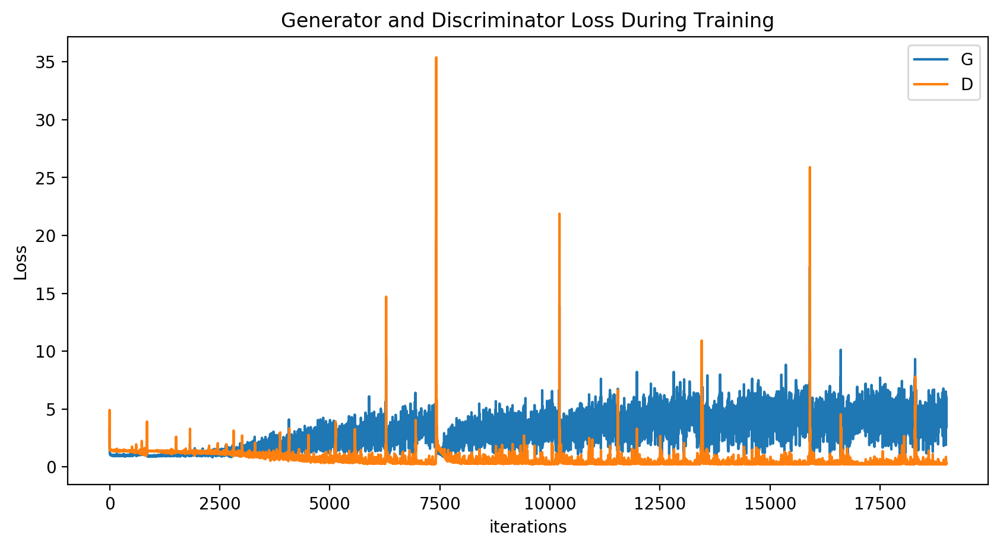

In [21]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(losses_g,label="G")
plt.plot(losses_d,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 21083427 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


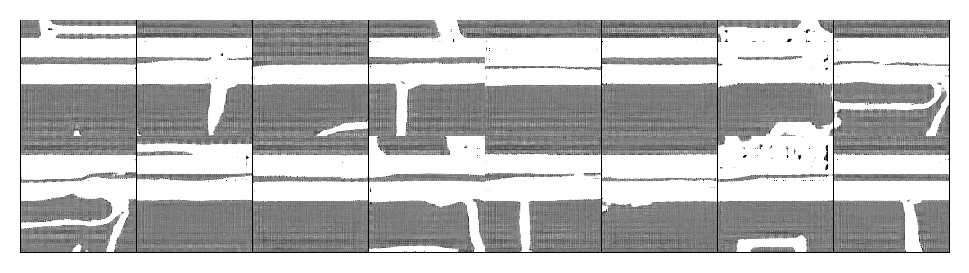

In [22]:
#%%capture
fig = plt.figure(figsize=(6,6))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in intermediate_images]
ani = animation.ArtistAnimation(fig, ims, interval=100, repeat_delay=2000, blit=True)

HTML(ani.to_jshtml())

### Evaluate trained generator model on test data (Qualitative)

In [23]:
labeled_testset = LabeledDataset(image_folder=data_dir,
                                  annotation_file=annotation_csv,
                                  scene_index=labeled_scene_index_test,
                                  img_transform=transforms.Compose([transforms.CenterCrop(256),
                                                                    transforms.ToTensor(),
                                                                    transforms.Normalize(mean=(0.5,), std=(0.5,))
                                                                   ]),
                                  map_transform=transforms.Compose([transforms.ToPILImage(),
                                                                    transforms.Resize(256),
                                                                    transforms.ToTensor()
                                                                   ]),
                                  extra_info=True
                                 )

testloader = torch.utils.data.DataLoader(labeled_testset,
                                          batch_size=1,
                                          shuffle=True,
                                          num_workers=2,
                                          collate_fn=collate_fn,
                                          pin_memory=True)

In [24]:
losses_g_L1_eval = []
inference_images = []

generator.eval()

Generator(
  (model): Sequential(
    (0): ReflectionPad2d((3, 3, 3, 3))
    (1): Conv2d(18, 64, kernel_size=(7, 7), stride=(1, 1))
    (2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): ReLU(inplace=True)
    (4): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (5): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (8): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (9): ReLU(inplace=True)
    (10): ResnetBlock(
      (resnet_block): Sequential(
        (0): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace=True)
        (3): Dropout(p=0.5, inplace=False)
        (4): Conv2d(256, 256, kernel_size=(3, 3), strid

In [25]:
####################################
############ INFERENCE #############
####################################

for real_18ch, real_map in tqdm(testloader):
    real_18ch = real_18ch.to(device)
    real_map = real_map.to(device)

    """
    GENERATOR INFERENCE
    """
    gen_map = generator(real_18ch)
    loss_g_L1 = criterion_L1(gen_map, real_map)

    """
    COMPILE TRAINING STATISTICS
    """
    losses_g_L1_eval.append(loss_g_L1.item())
    inference_images.append(np.hstack((real_map.cpu().view([1,256,256]), (gen_map.detach().cpu().view([1,256,256])*0.5) + 0.5)))

100%|██████████| 504/504 [00:25<00:00, 19.98it/s]


Animation size has reached 20989464 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


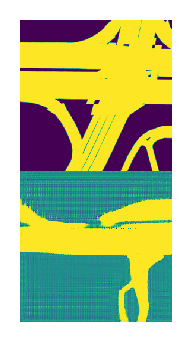

In [26]:
# %%capture
fig = plt.figure(figsize=(4,2))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)).squeeze(), animated=True)] for i in inference_images]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=2000, blit=True)

HTML(ani.to_jshtml())

#### 